# 1- Title : SinarMas

## CUSTOMER SEGMENTATION

# 2 - Introduction

- Nama : Didit Eko Setyo Ariandi
- Objective : made customer segmentation

# 3 - External Link

***TABLEU LINK : https://public.tableau.com/app/profile/didit.eko.setyo.ariandi1076/viz/Sinarmas/Dashboard1***

# 4 - Working Area

## Import Libraries

In [95]:
#import libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score, silhouette_samples
from sklearn.cluster import KMeans, AgglomerativeClustering, SpectralClustering
import matplotlib as mpl
from feature_engine.outliers import Winsorizer
from statsmodels.stats.outliers_influence import variance_inflation_factor
from yellowbrick.cluster import KElbowVisualizer
from matplotlib.ticker import FixedLocator, FixedFormatter
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.colors import ListedColormap
import plotly.express as px

## Data Loading

In [2]:
df = pd.read_excel('IndonesiaCreditData.xlsx', sheet_name="Dataset")
df

,No,Age,Sex,Job,Housing,Saving accounts,Checking account,Credit amount,Duration,Purpose
0,0,67,male,2,own,NaN,little,14494431,6,radio/TV
1,1,22,female,2,own,little,moderate,73786449,48,radio/TV
2,2,49,male,1,own,little,NaN,25988304,12,education
3,3,45,male,2,free,little,little,97728918,42,furniture/equipment
4,4,53,male,2,free,little,little,60383130,24,car
...,...,...,...,...,...,...,...,...,...,...
995,995,31,female,1,own,little,NaN,21524664,12,furniture/equipment
996,996,40,male,3,own,little,little,47822943,30,car
997,997,38,male,2,own,little,NaN,9968796,12,radio/TV
998,998,23,male,2,free,little,little,22876155,45,radio/TV


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 10 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   No                1000 non-null   int64 
 1   Age               1000 non-null   int64 
 2   Sex               1000 non-null   object
 3   Job               1000 non-null   int64 
 4   Housing           1000 non-null   object
 5   Saving accounts   817 non-null    object
 6   Checking account  606 non-null    object
 7   Credit amount     1000 non-null   int64 
 8   Duration          1000 non-null   int64 
 9   Purpose           1000 non-null   object
dtypes: int64(5), object(5)
memory usage: 78.2+ KB


In [4]:
df.describe()

,No,Age,Job,Credit amount,Duration
count,1000.000000,1000.000000,1000.000000,1.000000e+03,1000.000000
mean,499.500000,35.546000,1.904000,4.056033e+07,20.903000
std,288.819436,11.375469,0.653614,3.499911e+07,12.058814
min,0.000000,19.000000,0.000000,3.099750e+06,4.000000
25%,249.750000,27.000000,2.000000,1.693083e+07,12.000000
50%,499.500000,33.000000,2.000000,2.875948e+07,18.000000
75%,749.250000,42.000000,2.000000,4.925193e+07,24.000000
max,999.000000,75.000000,3.000000,2.284392e+08,72.000000


In [5]:
df.isnull().sum()

No                    0
Age                   0
Sex                   0
Job                   0
Housing               0
Saving accounts     183
Checking account    394
Credit amount         0
Duration              0
Purpose               0
dtype: int64

- terdapat missing value pada colum saving account dengan checking account

## Exploratory Data Analysis

In [6]:
#Matikan warnings
warnings.filterwarnings('ignore')

In [7]:
from dataprep.datasets import load_dataset
from dataprep.eda import create_report

  0%|          | 0/1328 [00:00<?, ?it/s]


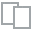
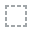
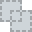
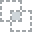
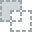
...
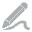
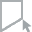
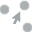
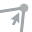
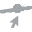

In [8]:
create_report(df).show()

- Berikut adalah EDA yang telah dilakukan yang berisi informasi tangtang dataset

<AxesSubplot:xlabel='Duration', ylabel='Credit amount'>

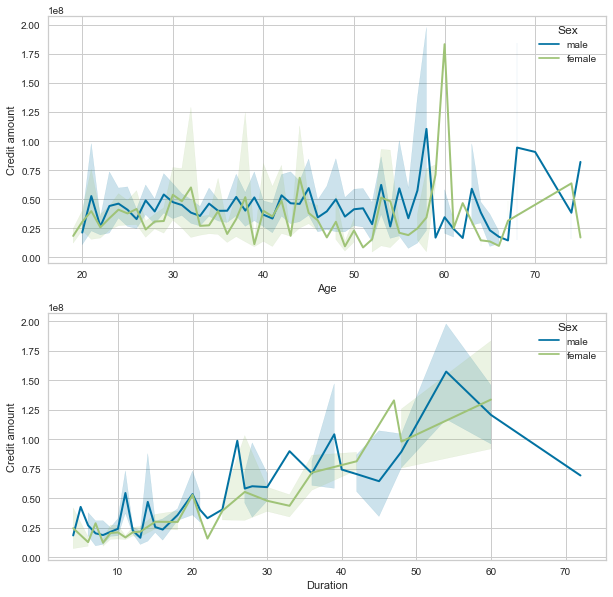

In [9]:
fig, ax = plt.subplots(2,1,figsize=(10,10))

sns.lineplot(data=df, x='Age', y='Credit amount', hue='Sex', lw=2, ax=ax[0])
sns.lineplot(data=df, x='Duration', y='Credit amount', hue='Sex', lw=2, ax=ax[1])

- berdasarakan line plot diatas dapat dilihat bahwa semakin besar umur dan duration semakin besar credit amount yang dimiliki

## Data Preprocecing

### Get data for model inference

In [10]:
## Get data for model inference
data_inf = df.sample(21, random_state=69)
data_inf

,No,Age,Sex,Job,Housing,Saving accounts,Checking account,Credit amount,Duration,Purpose
823,823,47,male,1,own,little,little,9063669,8,car
999,999,27,male,2,own,moderate,moderate,56737824,45,car
891,891,46,male,2,own,little,NaN,22677771,15,radio/TV
781,781,60,male,2,own,rich,NaN,24054060,24,car
967,967,54,female,3,rent,little,NaN,44239632,15,radio/TV
764,764,27,male,2,own,moderate,NaN,30538737,24,car
954,954,29,female,2,own,little,little,23471307,12,car
693,693,44,male,1,own,NaN,little,58473684,6,car
26,26,39,male,1,own,little,<NA>,5281974,6,radio/TV
99,99,36,male,3,rent,<NA>,moderate,87499743,20,car


In [11]:
# remove inference set from data set
df_train = df.drop(data_inf.index)
df_train

,No,Age,Sex,Job,Housing,Saving accounts,Checking account,Credit amount,Duration,Purpose
0,0,67,male,2,own,<NA>,little,14494431,6,radio/TV
1,1,22,female,2,own,little,moderate,73786449,48,radio/TV
2,2,49,male,1,own,little,<NA>,25988304,12,education
4,4,53,male,2,free,little,little,60383130,24,car
5,5,35,male,1,free,<NA>,<NA>,112272945,36,education
...,...,...,...,...,...,...,...,...,...,...
994,994,50,male,2,own,NaN,NaN,29633610,12,car
995,995,31,female,1,own,little,NaN,21524664,12,furniture/equipment
996,996,40,male,3,own,little,little,47822943,30,car
997,997,38,male,2,own,little,NaN,9968796,12,radio/TV


In [12]:
#reset index to reduce error
df_train.reset_index(drop= True, inplace=True)
data_inf.reset_index(drop=True, inplace=True)
data_inf

,No,Age,Sex,Job,Housing,Saving accounts,Checking account,Credit amount,Duration,Purpose
0,823,47,male,1,own,little,little,9063669,8,car
1,999,27,male,2,own,moderate,moderate,56737824,45,car
2,891,46,male,2,own,little,NaN,22677771,15,radio/TV
3,781,60,male,2,own,rich,NaN,24054060,24,car
4,967,54,female,3,rent,little,NaN,44239632,15,radio/TV
5,764,27,male,2,own,moderate,NaN,30538737,24,car
6,954,29,female,2,own,little,little,23471307,12,car
7,693,44,male,1,own,NaN,little,58473684,6,car
8,26,39,male,1,own,little,<NA>,5281974,6,radio/TV
9,99,36,male,3,rent,<NA>,moderate,87499743,20,car


### HANDLE mssing value

In [13]:
#cek missing value
df_train.isnull().sum()

No                    0
Age                   0
Sex                   0
Job                   0
Housing               0
Saving accounts     179
Checking account    387
Credit amount         0
Duration              0
Purpose               0
dtype: int64

- Dapat dilihat terdapat missing value pada column ssaving account dan checking account

In [14]:
#handle with missing value
df_train = df_train.fillna(method= 'bfill')

In [15]:
df_train.isnull().sum()

No                  0
Age                 0
Sex                 0
Job                 0
Housing             0
Saving accounts     0
Checking account    0
Credit amount       0
Duration            0
Purpose             0
dtype: int64

- handle missing value telah berhasil

### Handling outliers

In [16]:
# make function to see histogram distribusion data dan box plot outliers
def diagnostic_plots(df_train, variable):
    # Define figure size
    plt.figure(figsize=(16, 4))

    # Histogram
    plt.subplot(1, 2, 1)
    sns.histplot(df_train[variable], bins=30)
    plt.title('Histogram')

    # Boxplot
    plt.subplot(1, 2, 2)
    sns.boxplot(y=df_train[variable])
    plt.title('Boxplot')

    plt.show()
    
    print('skewness:', df_train[variable].skew())
    if (df_train[variable].skew() >= -0.5 ) | (df_train[variable].skew() <= 0.5 ) :
      print('the distribution is skewed')
    else:
      print('the distribution is normal')

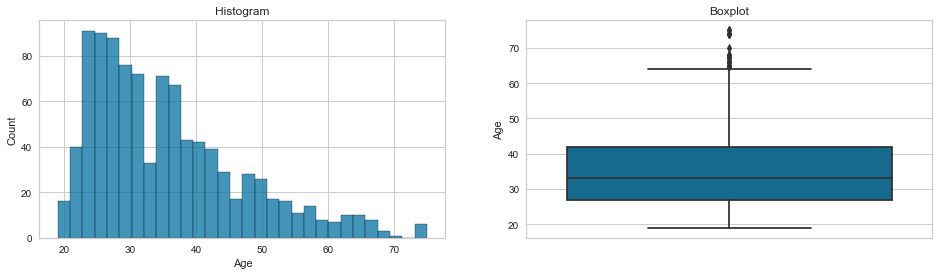

skewness: 1.0274165265248427
the distribution is skewed


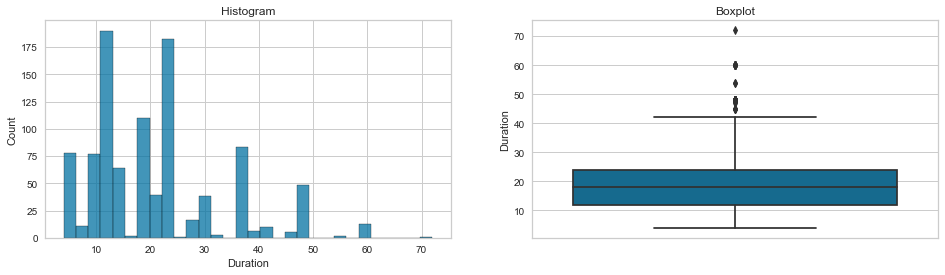

skewness: 1.094374301045631
the distribution is skewed


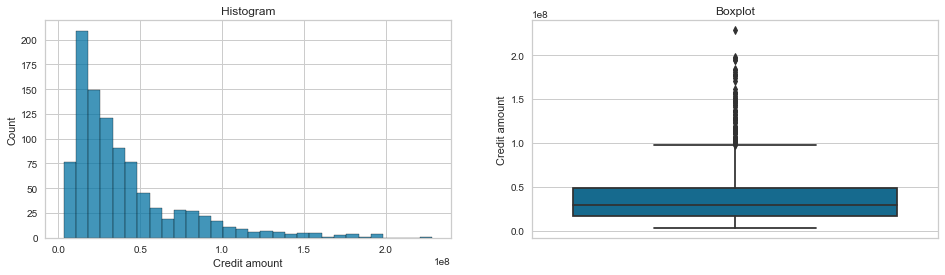

skewness: 1.9597222869081568
the distribution is skewed


In [17]:
#munculkan histogram dan boxplot Age
diagnostic_plots(df_train, 'Age')
#munculkan histogram dan boxplot Duration
diagnostic_plots(df_train, 'Duration')
#munculkan histogram dan boxplot Credit amount
diagnostic_plots(df_train, 'Credit amount')

- Terdapat outliers pada column Age dan dia anggap sbagai natural outliers 

In [18]:
def find_skewed_boundaries(df_train, variable, distance):
    IQR = df_train[variable].quantile(0.75) - df_train[variable].quantile(0.25)

    lower_boundary = df_train[variable].quantile(0.25) - (IQR * distance)
    upper_boundary = df_train[variable].quantile(0.75) + (IQR * distance)

    return upper_boundary, lower_boundary

In [19]:
# mencari upper limit san lower column numeric
upper_Duration, lower_Duration = find_skewed_boundaries(df_train, 'Duration', 1.5)
print('upper_Duration and lower_Duration = ', upper_Duration,' and ', lower_Duration)

upper_Credit, lower_Credit = find_skewed_boundaries(df_train, 'Credit amount', 1.5)
print('upper_Credit and lower_Credit = ', upper_Credit,' and ', lower_Credit)

upper_Duration and lower_Duration =  42.0  and  -6.0
upper_Credit and lower_Credit =  97468539.0  and  -31332273.0


In [20]:
# Fungsi untuk memfilter outlier (mencari outlier)
def find_outliers(df_train,variable,upper,lower):
  return df_train[
            (df_train[variable] > upper) |
            (df_train[variable] < lower)
            ]

In [21]:
print('Duration :',(find_outliers(df_train,'Duration',upper_Duration, lower_Duration)).shape[0])
print('Credit amount :',(find_outliers(df_train,'Credit amount',upper_Credit, lower_Credit)).shape[0])

Duration : 69
Credit amount : 73


- Didapatkan jumlah outliers yaitu 69 untuk duration dan 73 untuk credit amount

In [22]:
# membuat windsorizer
windsoriser = Winsorizer(capping_method='iqr', # choose iqr for IQR rule boundaries or gaussian for mean and std
                          tail='right', #right tails 
                          fold=1.5,
                          variables=['Duration', 'Credit amount'])

windsoriser.fit(df_train)

df_fin = windsoriser.transform(df_train)

- Handling outliers tealh dilakukan menggunakan windsorizer

### Feature Selection

In [23]:
df_fin.head()

,No,Age,Sex,Job,Housing,Saving accounts,Checking account,Credit amount,Duration,Purpose
0,0,67,male,2,own,little,little,14494431.0,6.0,radio/TV
1,1,22,female,2,own,little,moderate,73786449.0,42.0,radio/TV
2,2,49,male,1,own,little,little,25988304.0,12.0,education
3,4,53,male,2,free,little,little,60383130.0,24.0,car
4,5,35,male,1,free,quite rich,moderate,97468539.0,36.0,education


- Karna column No tidak memilki korelasi dengan column lainya maka akan didrop

In [24]:
# Drop Column No

df_fin.drop('No', axis=1, inplace=True)
df_fin

,Age,Sex,Job,Housing,Saving accounts,Checking account,Credit amount,Duration,Purpose
0,67,male,2,own,little,little,14494431.0,6.0,radio/TV
1,22,female,2,own,little,moderate,73786449.0,42.0,radio/TV
2,49,male,1,own,little,little,25988304.0,12.0,education
3,53,male,2,free,little,little,60383130.0,24.0,car
4,35,male,1,free,quite rich,moderate,97468539.0,36.0,education
...,...,...,...,...,...,...,...,...,...
974,50,male,2,own,little,little,29633610.0,12.0,car
975,31,female,1,own,little,little,21524664.0,12.0,furniture/equipment
976,40,male,3,own,little,little,47822943.0,30.0,car
977,38,male,2,own,little,little,9968796.0,12.0,radio/TV


In [25]:
#Memilih feature numerical dan categorical
num_columns =['Age', 'Credit amount','Duration']
cat_columns = ['Sex','Job', 'Housing','Saving accounts', 'Checking account', 'Purpose']

In [26]:
df_num = df_fin[num_columns]
df_cat = df_fin[cat_columns]

In [27]:
df_num

,Age,Credit amount,Duration
0,67,14494431.0,6.0
1,22,73786449.0,42.0
2,49,25988304.0,12.0
3,53,60383130.0,24.0
4,35,97468539.0,36.0
...,...,...,...
974,50,29633610.0,12.0
975,31,21524664.0,12.0
976,40,47822943.0,30.0
977,38,9968796.0,12.0


### Feature Scalling

kita akan menggunakan scalling menggunakan minmaxscaller dikarenakan seluruh data memiliki distribusi skew

In [28]:
#minmaxscaler
scaler =MinMaxScaler()
scaler.fit(df_num)

df_num_scaled = scaler.transform(df_num)
df_num_scaled

array([[0.85714286, 0.12074629, 0.05263158],
       [0.05357143, 0.74904743, 1.        ],
       [0.53571429, 0.24254369, 0.21052632],
       ...,
       [0.375     , 0.47391933, 0.68421053],
       [0.33928571, 0.07278938, 0.21052632],
       [0.07142857, 0.2095651 , 1.        ]])

- Dilakukannya feature scalling menggunakan MinmaxScaler dikarenakan distribusi data berbentuk skew

### Dimension Reduction

Lakukan dimension reduction untuk meringankan process clustering serta meningkatkan ketepatan hasil clustering.

In [29]:
df_final = pd.DataFrame(df_num_scaled, columns=num_columns)
df_final

,Age,Credit amount,Duration
0,0.857143,0.120746,0.052632
1,0.053571,0.749047,1.000000
2,0.535714,0.242544,0.210526
3,0.607143,0.607016,0.526316
4,0.285714,1.000000,0.842105
...,...,...,...
974,0.553571,0.281172,0.210526
975,0.214286,0.195244,0.210526
976,0.375000,0.473919,0.684211
977,0.339286,0.072789,0.210526


#### VIF

Lakukan VIF untuk melihat banyaknya dimensi yang di rekomendasikan

In [30]:
vif_data = pd.DataFrame()
vif_data["features"] = df_final.columns

#calculating VIF for each feature
vif_data["VIF"] = [variance_inflation_factor(df_final.values, i)
                        for i in range(len(df_final.columns))]
vif_data.sort_values(by='VIF',ascending=False)

,features,VIF
2,Duration,4.685552
1,Credit amount,4.478789
0,Age,1.910384


Jumlah dimensi yang direkomendasikan ditunjukkan dari banyaknya kolom dengan nilai VIF  yakni 3 dimensi

### EVR

In [31]:
pca = PCA()
pca.fit(df_final)
cumsum = np.cumsum(pca.explained_variance_ratio_)
d = np.argmax(cumsum >= 0.95) + 1
print(cumsum)
print(d)

[0.65313531 0.86144566 1.        ]
3


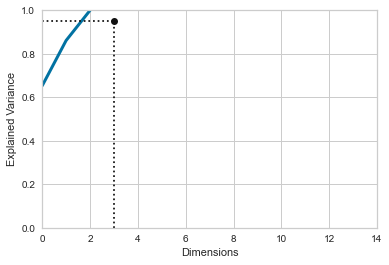

In [32]:
plt.figure(figsize=(6,4))
plt.plot(cumsum, linewidth=3)
plt.axis([0, 14, 0, 1])
plt.xlabel("Dimensions")
plt.ylabel("Explained Variance")
plt.plot([d, d], [0, 0.95], "k:")
plt.plot([0, d], [0.95, 0.95], "k:")
plt.plot(d, 0.95, "ko")
plt.grid(True)
plt.show()

Hasil EVR menunjukkan bahwa dengan menggunakan 3 dimensi telah mencakup 95% dari data. Maka 3 dimensi diambil sebagai jumlah dimensi PCA

### PCA

In [33]:
pca = PCA(n_components=3)
pca.fit(df_final)
df_reduce= pca.transform(df_final)

PCA sudah di lakukan

### N cluster

In [34]:
kmeans_per_k = [KMeans(n_clusters=k, random_state=21).fit(df_reduce)
                for k in range(1, 9)]

Elbow Method


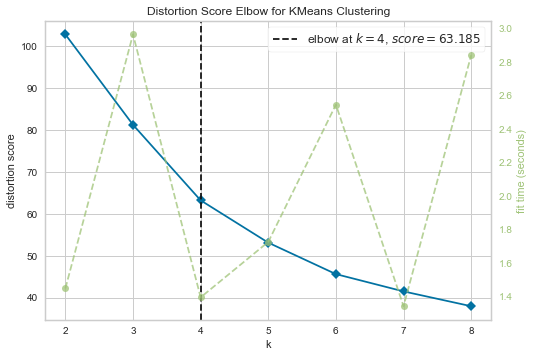

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [35]:
print('Elbow Method')
Elbow_M = KElbowVisualizer(KMeans(), k=8)
Elbow_M.fit(df_reduce)
Elbow_M.show()

- Hasil dari elbow method yang dilakukan didaptkan k terbaik ada pada 4

In [36]:
k=[2,3,4,5,6,7,8,9]
kmeans_per_k = [KMeans(n_clusters=k, random_state=21).fit(df_reduce)
                for k in range(1, 9)]
inertias = [model.inertia_ for model in kmeans_per_k]

In [37]:
inertias

[197.2159198283563,
 102.76382735434903,
 81.2025975177983,
 63.1851067265403,
 53.09209755420618,
 45.59271873739765,
 41.43617477027187,
 37.87431499578055]

In [38]:
silhouette_scores = [silhouette_score(df_reduce, model.labels_)
                     for model in kmeans_per_k[1:]]

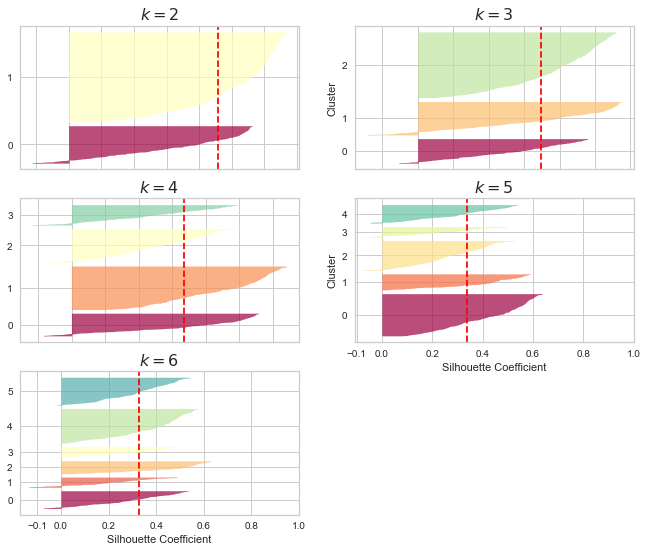

In [39]:
plt.figure(figsize=(11, 9))

for k in (2, 3, 4, 5, 6):
    plt.subplot(3, 2, k - 1)
    
    y_pred = kmeans_per_k[k - 1].labels_
    silhouette_coefficients = silhouette_samples(df_reduce, y_pred)

    padding = len(df_reduce) // 30
    pos = padding
    ticks = []
    for i in range(k):
        coeffs = silhouette_coefficients[y_pred == i]
        coeffs.sort()

        color = mpl.cm.Spectral(i / k)
        plt.fill_betweenx(np.arange(pos, pos + len(coeffs)), 0, coeffs,
                          facecolor=color, edgecolor=color, alpha=0.7)
        ticks.append(pos + len(coeffs) // 2)
        pos += len(coeffs) + padding

    plt.gca().yaxis.set_major_locator(FixedLocator(ticks))
    plt.gca().yaxis.set_major_formatter(FixedFormatter(range(k)))
    if k in (3, 5):
        plt.ylabel("Cluster")
    
    if k in (5, 6):
        plt.gca().set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])
        plt.xlabel("Silhouette Coefficient")
    else:
        plt.tick_params(labelbottom=False)

    plt.axvline(x=silhouette_scores[k - 2], color="red", linestyle="--")
    plt.title("$k={}$".format(k), fontsize=16)

plt.show()

- Melihat dari hasil ELbow dan silhouette, jumlah clsuter yang direkomendasikan adalah 4. Dilihat dari semua pisau (grafik) melewati garis merah dan bentuk masing-masing pisau tidak terlalu kontras

## Model definition

Notes :
Algorithm which will be used are KMeans,Spectral,Agglomerative.

Dengan metrics yang akan dipakai untuk mengevaluasi adalah pca 2d dan sihouette score

## Model Training

Semua model menggunakan hasil elbow dan silhouette visualization, maka n_clusters = 4  bagi semua model

### Kmeans

In [40]:
##KMeans
kmeans = KMeans(n_clusters=4, random_state=21)
kmeans.fit(df_reduce)

KMeans(n_clusters=4, random_state=21)

### Agglomerative

In [41]:
agglo = AgglomerativeClustering(n_clusters=4)
agglo.fit(df_reduce)

AgglomerativeClustering(n_clusters=4)

### Spectral

In [42]:
spectral = SpectralClustering(n_clusters=4, random_state=21)
spectral.fit(df_reduce)

SpectralClustering(n_clusters=4, random_state=21)

## MODEL EVALUTION

### 2Dimension

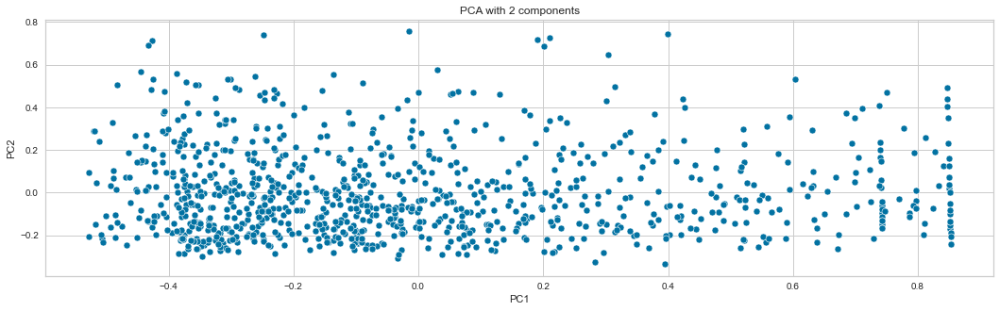

In [43]:
pca_2d = PCA(n_components=2, random_state=21)
X_2d  = pca_2d.fit_transform(df_reduce)

plt.figure(figsize=(18, 5))
sns.scatterplot(x=X_2d[:, 0], y=X_2d[:, 1])
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title('PCA with 2 components')
plt.show()

- gambar 2d dari disribusi data 

In [44]:
df_cluster = df_fin.copy()
df_cluster['cluster_Kmeans'] = kmeans.labels_
df_cluster['cluster_agglomerative'] = agglo.labels_
df_cluster['cluster_spectral']= spectral.labels_
df_cluster

,Age,Sex,Job,Housing,Saving accounts,Checking account,Credit amount,Duration,Purpose,cluster_Kmeans,cluster_agglomerative,cluster_spectral
0,67,male,2,own,little,little,14494431.0,6.0,radio/TV,3,0,0
1,22,female,2,own,little,moderate,73786449.0,42.0,radio/TV,0,3,1
2,49,male,1,own,little,little,25988304.0,12.0,education,3,0,0
3,53,male,2,free,little,little,60383130.0,24.0,car,3,0,0
4,35,male,1,free,quite rich,moderate,97468539.0,36.0,education,0,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...
974,50,male,2,own,little,little,29633610.0,12.0,car,3,0,0
975,31,female,1,own,little,little,21524664.0,12.0,furniture/equipment,1,2,3
976,40,male,3,own,little,little,47822943.0,30.0,car,2,0,1
977,38,male,2,own,little,little,9968796.0,12.0,radio/TV,1,0,3


- hasil dari perhitungan cluster menggunakan K-means, aggromerative dan spectral

### KMEANS

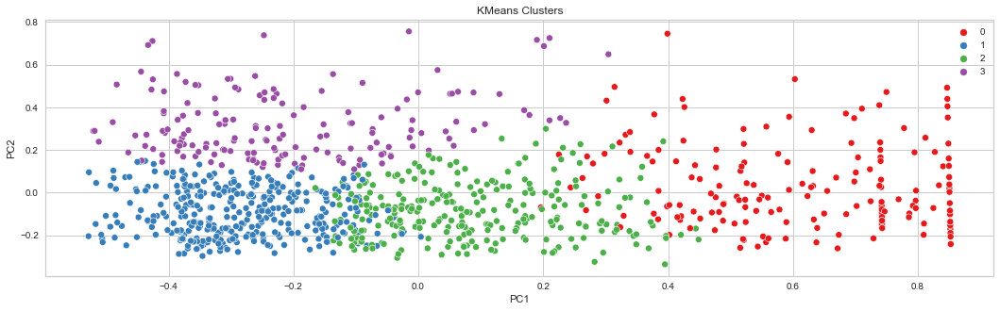

In [45]:
plt.figure(figsize=(18, 5))
sns.scatterplot(x=X_2d[:, 0], y=X_2d[:, 1], hue=kmeans.labels_, palette='Set1')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title('KMeans Clusters')
plt.show()

### AGGLOMERATIVE

Text(0.5, 1.0, 'Agglomerative Clusters')

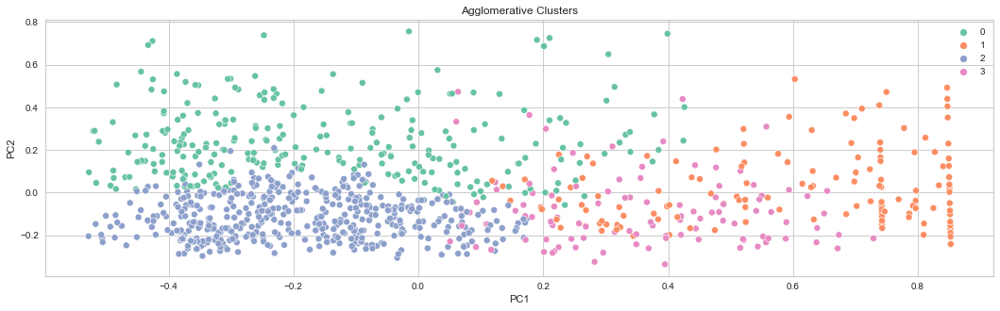

In [46]:
plt.figure(figsize=(18, 5))
sns.scatterplot(x=X_2d[:, 0], y=X_2d[:, 1], hue=agglo.labels_, palette='Set2')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title('Agglomerative Clusters')

### Spectral

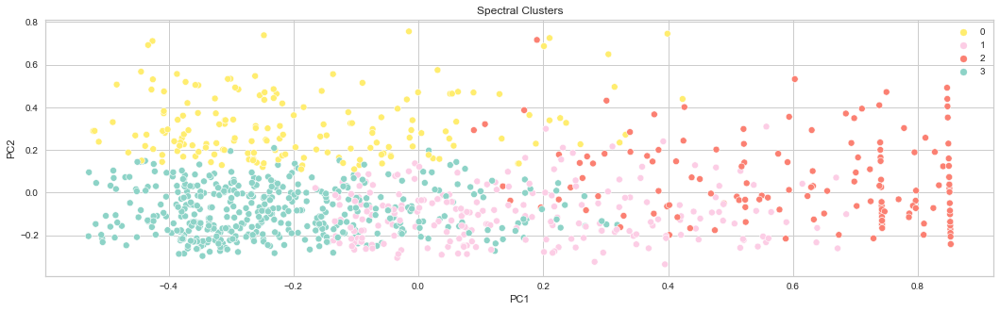

In [47]:
plt.figure(figsize=(18, 5))
sns.scatterplot(x=X_2d[:, 0], y=X_2d[:, 1], hue=spectral.labels_, palette='Set3_r')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title('Spectral Clusters')
plt.show()

- dapat dilihat dari 2D mapping, K means  menunjukkan hasil clustering dengan garis yang lebih jelas sedangkan pada agglomerative dan spectral masih terdapat cluster yang berantakan

### 3D mapping

In [48]:
pca_3d = PCA(n_components=3, random_state=21)
X_3d  = pca_3d.fit_transform(df_reduce)

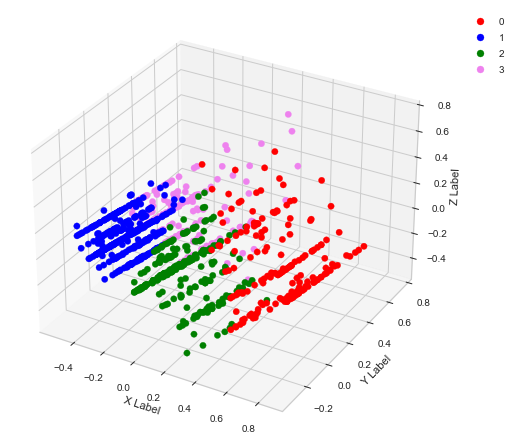

In [49]:
# generate data
x = X_3d[:,0]
y = X_3d[:,1]
z = X_3d[:,2]

# axes instance
fig = plt.figure(figsize=(6,6))
ax = Axes3D(fig, auto_add_to_figure=False)
fig.add_axes(ax)

# get colormap from seaborn
colors =["red","blue","green","Violet"]
cmap = ListedColormap(colors=colors)


# plot
sc = ax.scatter(x, y, z, s=40, c=kmeans.labels_, cmap=cmap, alpha=1)
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

# legend
plt.legend(*sc.legend_elements(), bbox_to_anchor=(1.05, 1), loc=2)

plt.show()

- ini bentuk 3d data dari hasil clustreing K-means yang dianggap yang terbaik di antara yang lainnya

In [101]:
fig = px.scatter_3d(df_cluster, x='Age', y='Duration', z='Credit amount',
              color='cluster_Kmeans')
fig.show()

## EDA SETELAH CLUSTERING

### Kmeans

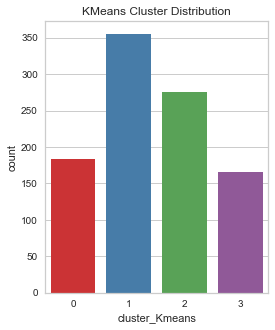

In [50]:
plt.figure(figsize=(4, 5))
sns.countplot(data=df_cluster, x='cluster_Kmeans', palette='Set1')
plt.title('KMeans Cluster Distribution')
plt.show()

### AGLOMERATIVE

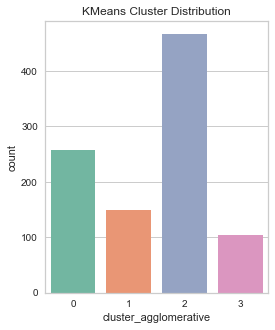

In [51]:
plt.figure(figsize=(4, 5))
sns.countplot(data=df_cluster, x='cluster_agglomerative', palette='Set2')
plt.title('KMeans Cluster Distribution')
plt.show()

### SPECTRAL

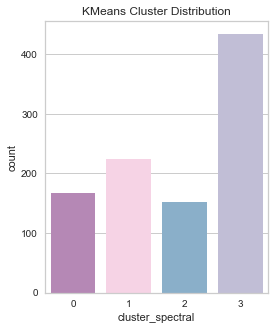

In [52]:
plt.figure(figsize=(4, 5))
sns.countplot(data=df_cluster, x='cluster_spectral', palette='Set3_r')
plt.title('KMeans Cluster Distribution')
plt.show()

## Silhoutte score 

In [53]:
print("silhouette score KMeans : ",silhouette_score(df_reduce,kmeans.labels_))
print("silhouette score Agglomerative : ",silhouette_score(df_reduce,agglo.labels_))
print("silhouette score Spectral : ",silhouette_score(df_reduce,spectral.labels_))

silhouette score KMeans :  0.3343029798224028
silhouette score Agglomerative :  0.2835836184154525
silhouette score Spectral :  0.3100182783053054


-Dari analisa di atasModel K means merupakan model terbaik bagi clustering data set ini karena memiliki visulaisasi paling baik dan nilai silhoutte score paling tinggi maka dari itu di putuskan bahwa model kmeans yang akan dipilih pada mode inference

## KMEANS RESULT

In [54]:
#mencoba pemisahan cluster
cluster0 = df_cluster[df_cluster['cluster_Kmeans'] == 0]
cluster1 = df_cluster[df_cluster['cluster_Kmeans'] == 1]
cluster2 = df_cluster[df_cluster['cluster_Kmeans'] == 2]
cluster3 = df_cluster[df_cluster['cluster_Kmeans'] == 3]

In [71]:
#membuat data final
final = pd.DataFrame()
final['df_cluster'] = [0,1,2,3]

for i in num_columns:
    data = []
    data.append(cluster0[i].mean())
    data.append(cluster1[i].mean())
    data.append(cluster2[i].mean())
    data.append(cluster3[i].mean())

    final[i] = data
    

In [72]:
final

,df_cluster,Age,Credit amount,Duration
0,0,36.065574,8.467989e+07,34.377049
1,1,29.805634,2.050012e+07,11.839437
2,2,31.851449,3.642350e+07,25.605072
3,3,53.460606,2.532785e+07,14.327273


- cluster 0 merupakan cluster dimana customer dengan umur menengah dengan credit amount tinggi dan duration tinggi
- cluster 1 merupakan cluster dimana customer dengan umur menengah dengan credit amount rendah dan duration rendah
- cluster 2 merupakan cluster dimana customer dengan umur menengah dengan credit amount rendah dan duration tinggi
- cluster 3 merupakan cluster dimana customer dengan umur tua dengan credit amount rendah dan duration tinggi

<AxesSubplot:xlabel='df_cluster'>

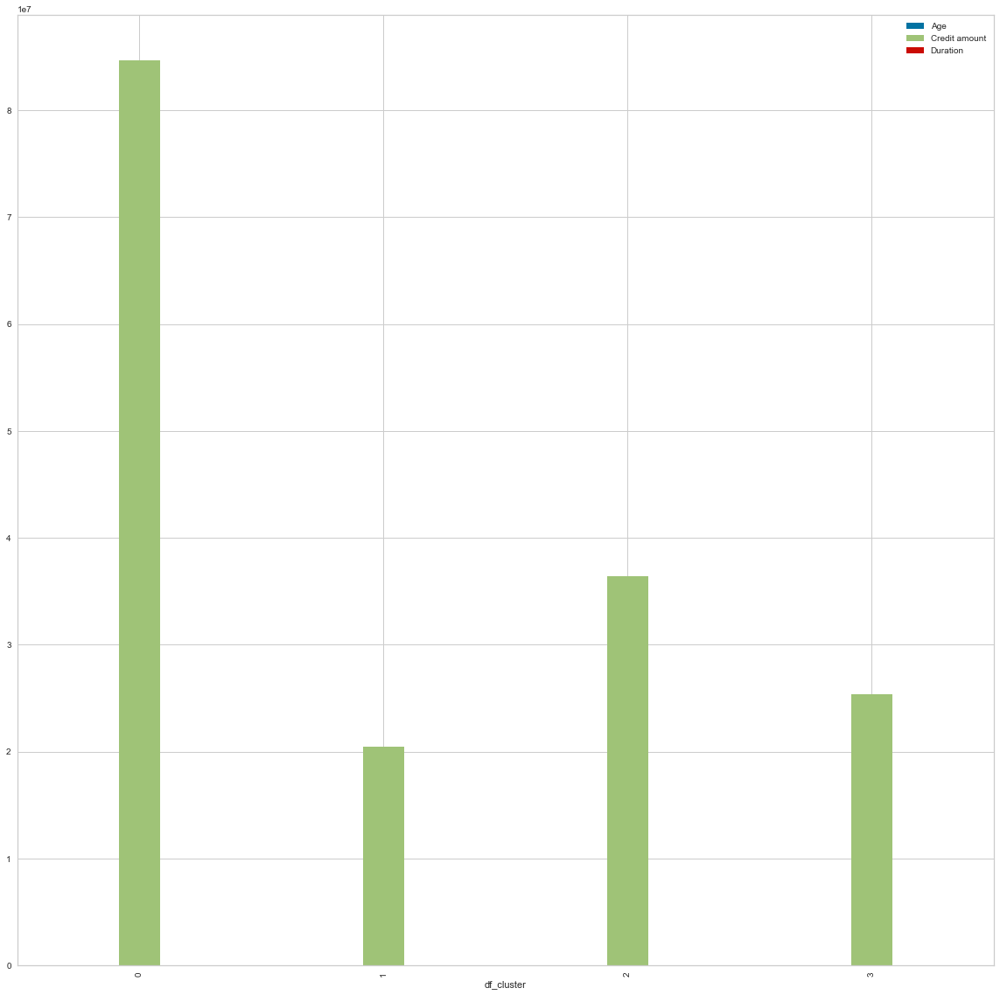

In [92]:
#plotting setiap cluster
data_plot = final.set_index('df_cluster')
data_plot.plot(kind='bar', figsize=(20, 20),)

- dapar dilihat bahwa mayoritas customer berada pada cluster 0 dan paling sedikit di cluster 1

### Model Inference 

In [76]:
#show data inf
data_inf

,No,Age,Sex,Job,Housing,Saving accounts,Checking account,Credit amount,Duration,Purpose
0,823,47,male,1,own,little,little,9063669,8,car
1,999,27,male,2,own,moderate,moderate,56737824,45,car
2,891,46,male,2,own,little,NaN,22677771,15,radio/TV
3,781,60,male,2,own,rich,NaN,24054060,24,car
4,967,54,female,3,rent,little,NaN,44239632,15,radio/TV
5,764,27,male,2,own,moderate,NaN,30538737,24,car
6,954,29,female,2,own,little,little,23471307,12,car
7,693,44,male,1,own,NaN,little,58473684,6,car
8,26,39,male,1,own,little,<NA>,5281974,6,radio/TV
9,99,36,male,3,rent,<NA>,moderate,87499743,20,car


In [77]:
#duplicate
data_inf1 = data_inf.copy()

In [93]:
#check missing value
data_inf.isnull().sum()

No                  0
Age                 0
Sex                 0
Job                 0
Housing             0
Saving accounts     4
Checking account    7
Credit amount       0
Duration            0
Purpose             0
dtype: int64

- dapat dilihat data inference memiliki missing value pada chceking dan saving account

In [85]:
#handle with missing value
data1 = data_inf.fillna(method= 'pad')
data1

,No,Age,Sex,Job,Housing,Saving accounts,Checking account,Credit amount,Duration,Purpose
0,823,47,male,1,own,little,little,9063669,8,car
1,999,27,male,2,own,moderate,moderate,56737824,45,car
2,891,46,male,2,own,little,moderate,22677771,15,radio/TV
3,781,60,male,2,own,rich,moderate,24054060,24,car
4,967,54,female,3,rent,little,moderate,44239632,15,radio/TV
5,764,27,male,2,own,moderate,moderate,30538737,24,car
6,954,29,female,2,own,little,little,23471307,12,car
7,693,44,male,1,own,little,little,58473684,6,car
8,26,39,male,1,own,little,little,5281974,6,radio/TV
9,99,36,male,3,rent,little,moderate,87499743,20,car


In [91]:
# split numerical
data_inf_num = data1[num_columns]
data_inf_num 

,Age,Credit amount,Duration
0,47,9063669,8
1,27,56737824,45
2,46,22677771,15
3,60,24054060,24
4,54,44239632,15
5,27,30538737,24
6,29,23471307,12
7,44,58473684,6
8,39,5281974,6
9,36,87499743,20


In [87]:
#scalling
data_inf_scaled = scaler.transform(data_inf_num)
data_inf_final = pd.DataFrame(data_inf_scaled, columns=num_columns)

In [88]:
#pca
df_inf_reduce = pca.transform(data_inf_final)

In [89]:
# model 
data_inf_cluster = data_inf.copy()

data_inf_cluster['cluster_Kmeans'] = kmeans.predict(df_inf_reduce)

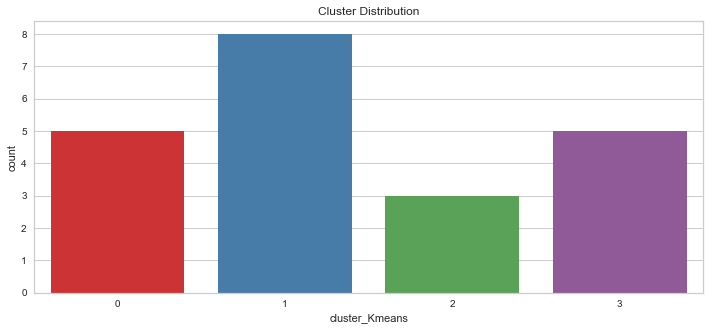

In [66]:
#plot
#show clustering result
plt.figure(figsize=(12, 5))
sns.countplot(data=data_inf_cluster, x='cluster_Kmeans', palette='Set1')
plt.title('Cluster Distribution')

plt.show()

- Dari hasil model inference ini didominasi oleh clustring 1 dimana customer dengan umur menengah dengan credit amount rendah dan duration rendah

# Conclusion / Overall Analysis

Dari proses EDA didapatkan:
1. Mayoritas customer mempunyai umur yang masih muda di antara 20-30 tahun
2. Mayoritas customer memiliki housing/kepemilkikan rumah didominasi memiliki snediri
3. Mayoritas customer mempunyai saving account yang sedikit dimana mereka yang paling banyak menggunakan credit 
4. Mayoritas customer memiliki checking account yg sedikit dan moderate
5. Jumlah credit ammount yang dimiliki customer di dominasi angka 50 juta
6. dari tujuan customer menggunakan credit didominasi dengan tujuan membeli mobil dan tv/radio
7. berdasarakan line plot diatas dapat dilihat bahwa semakin besar umur dan duration semakin besar credit amount yang dimiliki


Dari data proprocessing:
1. Semua kolom numeric dipilih karena menggunakan model PCA
2. Terdapat missing value pada minimu payment, maka data di handle dengan input method bfill dan pad.
3. Terdapat ouliers pada seluruh data numerik, maka outliers dihanlde dengan capping winsorizer .
4. Selanjutnya lakukan scaling dengan menggunakan minmaxscaller dikarenakan seluruh data memiliki distribusi skew.
5. Hasil EVR dan elbow menunjukkan dimensi yang disarankan adalah 3 dimensi, maka PCA akan dilakukan dengan jumlah dimensi 3.
6. Melihat dari hasil ELbow dan silhouette, jumlah clsuter yang direkomendasikan adalah 4

Dari model evaluation:
1. Dilihat dari 2D  K means dan spectral menunjukkan hasil clustering dengan garis yang lebih baik
2. Seperti hasil analisis pada 2D dan 3D, hasil silhouette score juga menunjukkan bahwa K means menunjukkan performa yang paling baik.

Hasil EDA setelah clustering:
1. - cluster 0 merupakan cluster dimana customer dengan umur menengah dengan credit amount tinggi dan duration tinggi
- cluster 1 merupakan cluster dimana customer dengan umur menengah dengan credit amount rendah dan duration rendah
- cluster 2 merupakan cluster dimana customer dengan umur menengah dengan credit amount rendah dan duration tinggi
- cluster 3 merupakan cluster dimana customer dengan umur tua dengan credit amount rendah dan duration tinggi

2. Model K means merupakan model terbaik bagi clustering data set ini karena memiliki visulaisasi paling baik dan nilai silhoutte score paling tinggi
2. Hasil clustering juga menunjukkan hasil yang baik dari visusalisasi 2D dan silhouette score.
3. Data inference juga berhasil dilakukan dengan memilih model K means sevbagi model terbai diantra model lainnya
